In [1]:
!pip install bertopic datasets datamapplot transformers sentence-transformers

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.6/150.6 kB 3.1 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 150.9/150.9 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.6/4.6 MB 57.1 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 101.3 MB/s eta 0:00:0000:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.2/49.2 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.5 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.4 MB/s eta 0:00:00:00:0100:01

In [11]:
import numpy as np 
import pandas as pd 
import re
import os
import torch
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
import matplotlib.pyplot as plt
from bertopic import BERTopic
from copy import deepcopy
from bertopic.representation import KeyBERTInspired
from bertopic.representation import MaximalMarginalRelevance
from transformers import pipeline
from bertopic.representation import TextGeneration

In [3]:
print(torch.cuda.is_available())

True


In [4]:
DATA_PATH = '/kaggle/input/sentiment140/training.1600000.processed.noemoticon.csv'

In [5]:
COLUMNS = ['target','ids','date','flag','user','text']

In [6]:
df = pd.read_csv(DATA_PATH,encoding = "ISO-8859-1",names = COLUMNS)

In [7]:
df.shape

(1600000, 6)

In [39]:
reduced_df = df.loc[:249999,'text']

In [41]:
reduced_df.shape

(250000,)

In [40]:
reduced_df.head()

0    @switchfoot http://twitpic.com/2y1zl - Awww, t...
1    is upset that he can't update his Facebook by ...
2    @Kenichan I dived many times for the ball. Man...
3      my whole body feels itchy and like its on fire 
4    @nationwideclass no, it's not behaving at all....
Name: text, dtype: object

In [42]:
reduced_df.iloc[0]

"@switchfoot http://twitpic.com/2y1zl - Awww, that's a bummer.  You shoulda got David Carr of Third Day to do it. ;D"

# Processing Text

In [43]:
def remove_links(text):
    clean_link = "@\S+|https?:\S+|http?:\S|[^A-Za-z0-9]+"
    cleaned_text = re.sub(clean_link,' ',str(text))
    return cleaned_text.strip()
    

In [44]:
reduced_df = reduced_df.apply(lambda x : remove_links(x))

# Creating embedding Model using Sentence Transformer

In [45]:
MODEL_PATH ="thenlper/gte-small"
embedding_model = SentenceTransformer(MODEL_PATH)
embeddings = embedding_model.encode(reduced_df,show_progress_bar=True)

modules.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/68.1k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/57.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/583 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/66.7M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/394 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/712k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Batches:   0%|          | 0/7813 [00:00<?, ?it/s]

In [46]:
embeddings.shape

(250000, 384)

# Creating dimensionality reduction model using UMAP

In [47]:
umap_model = UMAP( n_components=5, min_dist=0.0,metric='cosine', random_state=42)
low_dim_emb = umap_model.fit_transform(embeddings)

In [48]:
low_dim_emb.shape

(250000, 5)

# Creating clustering model using HDBSCAN

In [49]:
hdbscan_model = HDBSCAN(min_cluster_size=50, metric='euclidean',cluster_selection_method="eom").fit(low_dim_emb)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

# Investigating Clusters

In [50]:
clusters = hdbscan_model.labels_
no_of_clusters = len(set(clusters))
print(f'Number of cluster created is {no_of_clusters}')

Number of cluster created is 565


In [51]:
cluster = 0
for i in np.where(cluster == clusters)[0][:20]:
  print(reduced_df[i])

isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry
isPlayer Has Died Sorry


In [52]:
umap2_model = UMAP(n_components = 2, min_dist=0.0,metric='cosine', random_state=42)
visualized_emb = umap2_model.fit_transform(embeddings)

In [53]:
visualized_emb.shape

(250000, 2)

# Visualizing Clusters

In [54]:
corrid_df = pd.DataFrame(visualized_emb,columns=["x","y"])

In [55]:
reduced_df = pd.concat([reduced_df, corrid_df], axis=1)

In [56]:
reduced_df['clusters'] = [str(c) for c in clusters]

In [57]:
reduced_df.head()

,text,x,y,clusters
0,Awww that s a bummer You shoulda got David Car...,3.165937,4.178043,361
1,is upset that he can t update his Facebook by ...,0.899438,0.944617,-1
2,I dived many times for the ball Managed to sav...,7.404008,1.245252,-1
3,my whole body feels itchy and like its on fire,6.610206,9.030110,-1
4,no it s not behaving at all i m mad why am i h...,3.822347,3.240437,-1


In [58]:
outliers_df = reduced_df.loc[reduced_df['clusters'] == "-1"]

In [59]:
non_outliers_df = reduced_df.loc[reduced_df['clusters'] != "-1"]

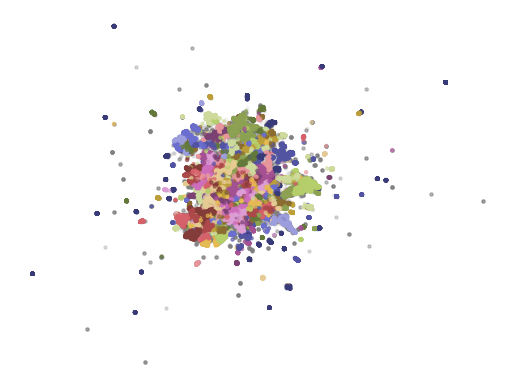

In [60]:
plt.scatter(outliers_df["x"],outliers_df["y"],c="grey", alpha=0.05, s=5)
plt.scatter(non_outliers_df["x"],non_outliers_df["y"],c=non_outliers_df["clusters"].astype(int),cmap="tab20b",alpha=0.6, s=5)
plt.axis("off")
plt.show()

# Creating Topic Model using bertopic

In [61]:
topic_model = BERTopic(
    embedding_model= embedding_model,
    umap_model = umap_model,
    hdbscan_model = hdbscan_model,
    verbose = False
).fit(reduced_df['text'],embeddings)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [62]:
topic_model.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,110946,-1_to_and_the_but,"[to, and, the, but, in, it, for, you, of, on]",[the last thing i wanted to do was upset you t...
1,0,4870,0_twitter_tweet_tweets_tweeting,"[twitter, tweet, tweets, tweeting, twittering,...","[i don t get twitter, can t work twitter, twit..."
2,1,2588,1_rain_raining_rainy_rained,"[rain, raining, rainy, rained, rains, wet, wea...","[it s rain day, rain rain go away come again s..."
3,2,2099,2_phone_iphone_cell_battery,"[phone, iphone, cell, battery, charger, phones...","[F Lost my phone, how no phone, i lost my phone]"
4,3,1947,3_pic_camera_picture_pics,"[pic, camera, picture, pics, upload, photos, p...","[cant upload a profile pic, i cant upload my p..."
...,...,...,...,...,...
560,559,51,559_kiss_kisses_kissed_kissin,"[kiss, kisses, kissed, kissin, baylee, tisk, k...","[No one s sent me a kiss yet, I m depressed I ..."
561,560,51,560_tyson_mike_daughter_exodus,"[tyson, mike, daughter, exodus, family, prayer...","[R I P to Mike Tyson s daughter, mike tyson s ..."
562,561,51,561_city_town_antibes_btown,"[city, town, antibes, btown, hometown, cities,...","[And I am not in town, COME TO THE CITY, I m i..."
563,562,51,562_sniff_sniffles_sniffle_sniffly,"[sniff, sniffles, sniffle, sniffly, gots, smel...","[i cant be again sniff sniff, sniff sniff and ..."


In [63]:
topic_model.get_topic(10)

[('mom', 0.04466379828967478),
 ('mother', 0.039929499128707475),
 ('mothers', 0.034378813149501766),
 ('mommy', 0.02084178261150228),
 ('mum', 0.01674651038581774),
 ('happy', 0.013238515020575822),
 ('day', 0.010675881055189452),
 ('moms', 0.008852058964855608),
 ('mama', 0.008737044473999325),
 ('her', 0.008392580459257254)]

# Visualizing Generated Trends

In [64]:
vis = topic_model.visualize_documents(reduced_df['text'],width=1200, hide_annotations=True, reduced_embeddings=visualized_emb)
vis.update_layout(font=dict(size=16))

In [65]:
topic_model.visualize_barchart()

In [66]:
topic_model.visualize_heatmap(n_clusters=50)

In [67]:
original_topics = deepcopy(topic_model.topic_representations_)

In [99]:
def print_difference(model, original_topics = original_topics, n_topics = 5):
    results_df = pd.DataFrame(columns = ['Topic','Updated','Original'])
    for i in range(n_topics):
        original = '| '.join(list(zip(*original_topics[i]))[0][:5])
        new = '| '.join(list(zip(*model.get_topic(i)))[0][:5])
        results_df.loc[len(results_df)] = [i,new,original]
    return results_df

# Using Keyinspired 

In [80]:
representation_model = KeyBERTInspired()
topic_model.update_topics(reduced_df['text'],representation_model=representation_model)

In [81]:
print_difference(topic_model,n_topics = 10)

,Topic,Updated,Original
0,0,twitter| twitters| twittered| tweeting| twitte...,twitter| tweet| tweets| tweeting| twittering
1,1,rain| raining| rained| rains| rainy,rain| raining| rainy| rained| rains
2,2,phone| phones| cellphone| iphone| mobile,phone| iphone| cell| battery| charger
3,3,uploading| upload| uploaded| pic| pics,pic| camera| picture| pics| upload
4,4,hot| hottest| hotter| heat| warm,hot| cold| snow| heat| degrees
5,5,amp| tired| my| work| listen,amp| up| out| all| get
6,6,dog| dogs| doggy| pet| pets,dog| puppy| dogs| vet| pet
7,7,exams| exam| studying| studyin| studied,exams| exam| study| studying| test
8,8,money| cash| dollars| paying| funds,money| bank| wallet| bills| ebay
9,9,car| cars| auto| drove| vehicle,car| accident| cars| driving| truck


# Using MaximalMarginalRelevance

In [82]:
representation_model = MaximalMarginalRelevance(diversity=0.5)
topic_model.update_topics(reduced_df['text'],representation_model=representation_model)

In [83]:
print_difference(topic_model,n_topics = 10)

,Topic,Updated,Original
0,0,tweets| twittering| friends| follow| updates,twitter| tweet| tweets| tweeting| twittering
1,1,raining| pouring| looks| morning| supposed,rain| raining| rainy| rained| rains
2,2,charger| phones| new| verizon| dying,phone| iphone| cell| battery| charger
3,3,pics| background| change| canon| cam,pic| camera| picture| pics| upload
4,4,degrees| warm| snowing| freezing| ac,hot| cold| snow| heat| degrees
5,5,amp| out| get| tired| work,amp| up| out| all| get
6,6,dog| vet| puppies| pets| our,dog| puppy| dogs| vet| pet
7,7,exams| study| tomorrow| final| weeks,exams| exam| study| studying| test
8,8,money| ebay| broke| credit| afford,money| bank| wallet| bills| ebay
9,9,car| accident| driving| van| ford,car| accident| cars| driving| truck


# Using flan-t5

In [110]:
MODEL_PATH  ="google/flan-t5-base"
prompt = """I have a topic that contains the following documents:
[DOCUMENTS]
The topic is described by the following keywords: '[KEYWORDS]'.
Based on the documents and keywords, what is this topic about?"""
generator = pipeline("text2text-generation" , model =MODEL_PATH)
representation_model = TextGeneration(generator,prompt=prompt,doc_length=50, tokenizer="whitespace")
topic_model.update_topics(reduced_df['text'],representation_model=representation_model)

config.json:   0%|          | 0.00/1.40k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/147 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/2.54k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.20k [00:00<?, ?B/s]

Device set to use cuda:0


In [111]:
print_difference(topic_model,n_topics = 10)

,Topic,Updated,Original
0,0,Twitter| | | |,twitter| tweet| tweets| tweeting| twittering
1,1,weather| | | |,rain| raining| rainy| rained| rains
2,2,cell phone| | | |,phone| iphone| cell| battery| charger
3,3,photo| | | |,pic| camera| picture| pics| upload
4,4,temperature| | | |,hot| cold| snow| heat| degrees
5,5,i am so sick amp tired of it all| | | |,amp| up| out| all| get
6,6,dog| | | |,dog| puppy| dogs| vet| pet
7,7,science| | | |,exams| exam| study| studying| test
8,8,money| | | |,money| bank| wallet| bills| ebay
9,9,car| | | |,car| accident| cars| driving| truck


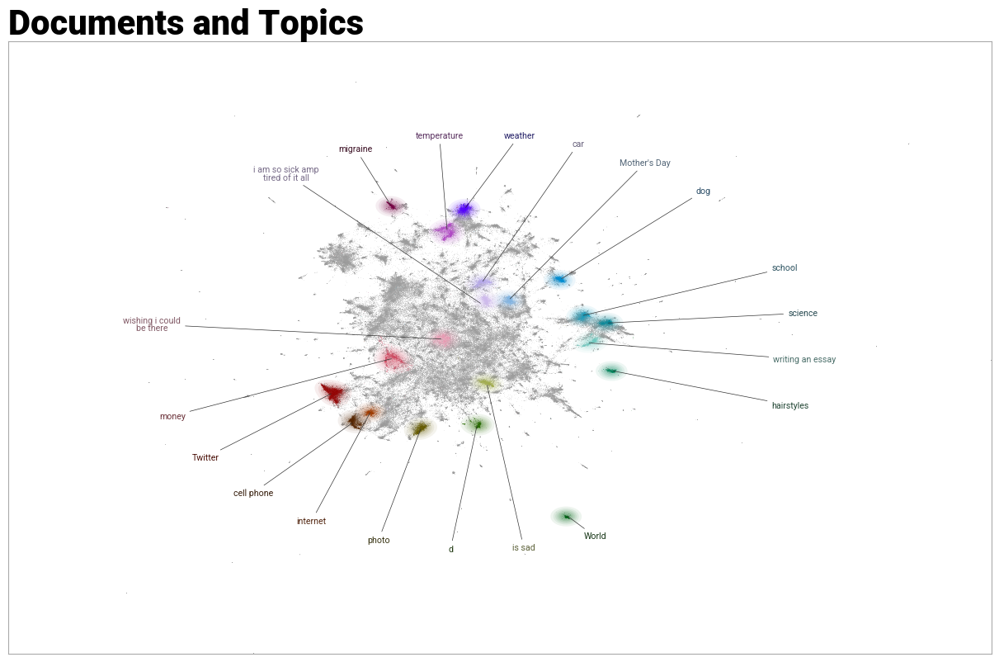

In [112]:
vis = topic_model.visualize_document_datamap(
    topics=list(range(20)),
    reduced_embeddings = visualized_emb,
    width=1200,

)

In [113]:
topic_model.visualize_barchart()